<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"></ul></div>

In [2]:
import datetime as dt
import numpy as np
import xarray as xr
from numpy import dtype
from netCDF4 import Dataset
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from matplotlib import gridspec
from matplotlib.pyplot import cm
from math import *
from locations import *

In [3]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:75% !important; }</style>"))

In [8]:
%%capture
# single column version

storm = 'rotstrong'

############################
if storm == 'rotstrong':
    path = '../../../../../Volumes/ONeillLab_AACPdata/originalstrong/homeyer-strong-lrg-rot.0'
    fileend = '.000000.nc'
    cross1 = -12.23
    cross2 = -12.22
if storm == 'rotweak':
    path = rotweakpath
    prefix = rotweakprefix
    fileend = rotweakfileend
    cross1 = -16.926
    cross2 = -16.923
############################


jdexv = [1800 + 300*i for i in range(7)]
y1 = cross1
y2 = cross2
x1 = 40-121;
x2 = 80-121;
# x1 = 45-121;
# x2 = 65-121;
ysel = slice(y1,y2)
xsel = slice(x1,x2)
zsel = slice(10,20)

cm2 = plt.get_cmap('Blues')

dpi = 450 * 2
mpl.rcParams['figure.dpi']=dpi

cm = 1/2.54

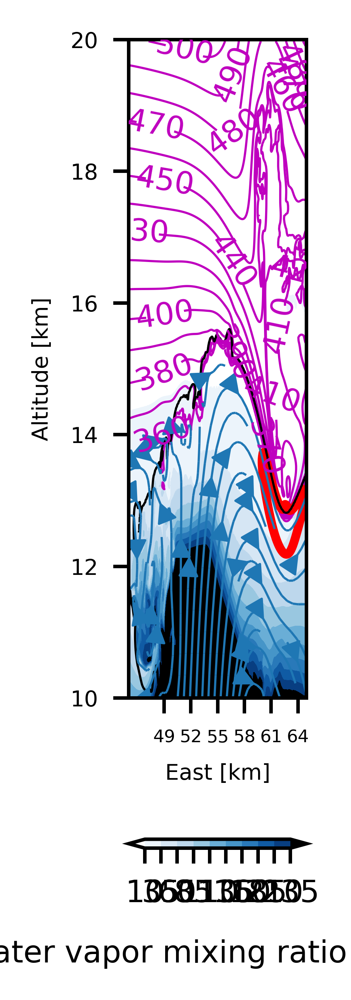

In [26]:
for ind in range(3,4):
    jdex = jdexv[ind]
    file = path + str(jdex) + fileend
    ds = xr.open_dataset(file)
    f, ax = plt.subplots(1,1,figsize = (3*cm,8.5*cm))

    xh = ds['xh'].sel(xh=xsel)+121 #arbitrary addition to avoid negative locations
    yh = ds['yh'].sel(yh=ysel)+55  #arbitrary addition to avoid negative locations
    zh = ds['zh'].sel(zh=zsel)

    x = np.arange(xh[0],xh[-1]+0.050,0.050)  # model grid spaces aren't perfectly 50 m apart,
    z = np.arange(zh[0],zh[-1],0.050)        # so correct for small machine error discrepancies

    u = np.squeeze(ds['uinterp'].sel(xh=xsel,yh=ysel,zh=zsel))
    v = np.squeeze(ds['vinterp'].sel(xh=xsel,yh=ysel,zh=zsel))
    w = np.squeeze(ds['winterp'].sel(xh=xsel,yh=ysel,zh=zsel))
    windspeed = np.sqrt(u**2+v**2+w**2)

    qvpert = np.squeeze(ds['qvpert'].sel(xh=xsel,yh=ysel,zh=zsel))
    qv0    = np.squeeze(ds['qv0'].sel(zh=zsel))
    qv03dtile = np.tile(qv0,(len(x),1))
    qv = (qv03dtile.T + qvpert)/1000.
    del qv03dtile, qvpert

    thpert = np.squeeze(ds['thpert'].sel(xh=xsel,yh=ysel,zh=zsel))
    th0    = np.squeeze(ds['th0'].sel(zh=zsel))
    th03dtile = np.tile(th0,(len(x),1))
    theta = th03dtile.T + thpert
    del th03dtile, thpert

    qc = np.squeeze(ds['qc'].sel(xh=xsel,yh=ysel,zh=zsel))/1000.
    qi = np.squeeze(ds['qi'].sel(xh=xsel,yh=ysel,zh=zsel))/1000.
    qg = np.squeeze(ds['qg'].sel(xh=xsel,yh=ysel,zh=zsel))/1000.
    qs = np.squeeze(ds['qs'].sel(xh=xsel,yh=ysel,zh=zsel))/1000.


    levels1 = [10 + 25*n for n in range(10)]
    cm2.set_over((0., 0., 0.))
    cm2.set_under((1., 1., 1.))
    qvax = ax.contourf(x,z,qv*28.97/18.02*10**6,levels=levels1,cmap=cm2,extend='both')

    levels2 = np.arange(360,540,10)
    cs = ax.contour(x,z,theta,levels=levels2,
                 linewidths=0.5,colors='m')#[colors[ind]])
    ax.clabel(cs,inline=1,fontsize=7,fmt='%.f')

    #plot windspeed contour
    ax.contour(x,z,windspeed,[75],colors='r',linewidths=2)

    #plot condensed cloud water mass mixing ratio
    ax.contour(x,z,qc+qi+qg+qs,[5e-5],colors='k',linewidths=0.5)

    #plot streamlines in-plane, only above 360 K surface
    ax.streamplot(x,z,u*(theta<360),w*(theta<360),linewidth=0.5) # FLAG
    ax.set_ylim(10,20)
    ax.set_ylabel('Altitude [km]',fontsize=5)

    ax.set_xlabel('East [km]',fontsize=5)
    ax.set_xticks(range(49,67, 3))
    ax.tick_params(axis='x',labelsize=4)
    ax.tick_params(axis='y',labelsize=5)
    #ax[rr].set_title(np.str(jdex/60)+' min at y='+np.str(yh.values),fontsize=9)#+', '+np.str(yh.values-55))

    cbar = f.colorbar(qvax,ax=ax,
            boundaries = levels1,
            extendfrac='auto',orientation='horizontal')
            #spacing='proportional'
            #orientation='horizontal'
    cbar.set_label("water vapor mixing ratio [ppmv]",fontsize=7,labelpad=+7)
    cbar.ax.tick_params(labelsize=7)


    plt.tight_layout(h_pad=1.25)
    plt.savefig('final_figures/snapshot_for_tropo_air_thru_mountain.jpeg')

/var/folders/3l/phmqvp1s6y5_l56qp_wwfrb80000gn/T/ipykernel_97093/1654909350.py:64: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[rr].set_xticklabels(empty_string_labels)
/var/folders/3l/phmqvp1s6y5_l56qp_wwfrb80000gn/T/ipykernel_97093/1654909350.py:70: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[rr].set_yticklabels(empty_string_labels)
/var/folders/3l/phmqvp1s6y5_l56qp_wwfrb80000gn/T/ipykernel_97093/1654909350.py:87: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[rr].set_xticklabels(empty_string_labels)
/var/folders/3l/phmqvp1s6y5_l56qp_wwfrb80000gn/T/ipykernel_97093/1654909350.py:70: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[rr].set_yticklabels(empty_string_labels)
/var/folders/3l/phmqvp1s6y5_l56qp_wwfrb80000gn/T/ipykernel_97093/1654909350.py:87: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[rr].set_xticklabels(e

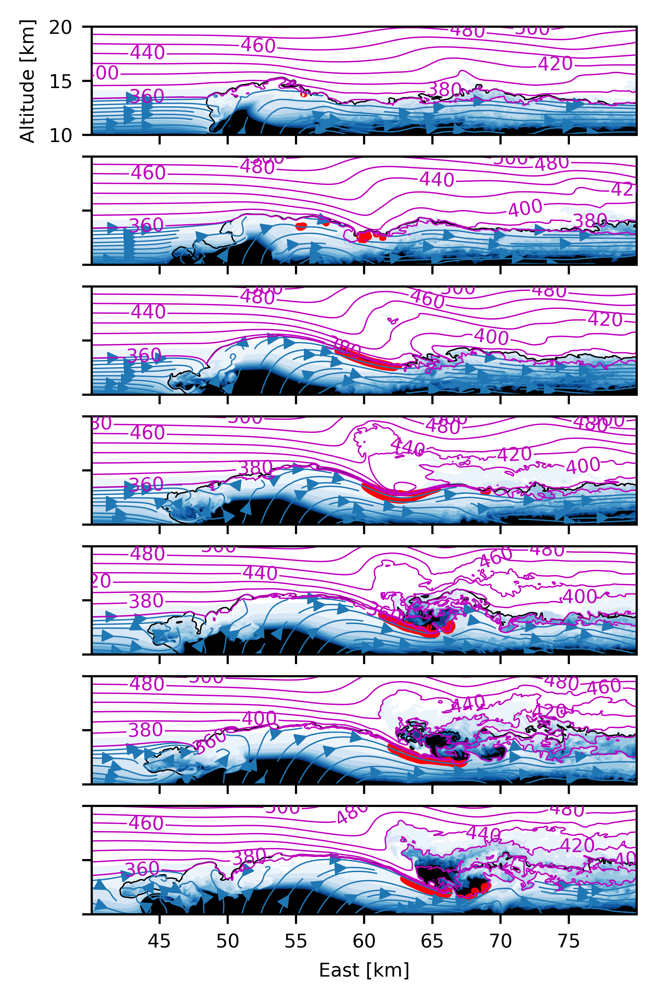

In [9]:
# single column version

f, ax = plt.subplots(7,1,figsize = (9.15*cm,15*cm))

for rr in range(7):
    jdex = jdexv[rr]
    file = path + str(jdex) + fileend
    ds = xr.open_dataset(file)

    xh = ds['xh'].sel(xh=xsel)+121 #arbitrary addition to avoid negative locations
    yh = ds['yh'].sel(yh=ysel)+55  #arbitrary addition to avoid negative locations
    zh = ds['zh'].sel(zh=zsel)
    #print(yh)

    x = np.arange(xh[0],xh[-1]+0.050,0.050)  # model grid spaces aren't perfectly 50 m apart,
    z = np.arange(zh[0],zh[-1],0.050)        # so correct for small machine error discrepancies

    u = np.squeeze(ds['uinterp'].sel(xh=xsel,yh=ysel,zh=zsel))
    v = np.squeeze(ds['vinterp'].sel(xh=xsel,yh=ysel,zh=zsel))
    w = np.squeeze(ds['winterp'].sel(xh=xsel,yh=ysel,zh=zsel))
    windspeed = np.sqrt(u**2+v**2+w**2)

    qvpert = np.squeeze(ds['qvpert'].sel(xh=xsel,yh=ysel,zh=zsel))
    qv0    = np.squeeze(ds['qv0'].sel(zh=zsel))
    qv03dtile = np.tile(qv0,(len(x),1))
    qv = (qv03dtile.T + qvpert)/1000.
    del qv03dtile, qvpert

    thpert = np.squeeze(ds['thpert'].sel(xh=xsel,yh=ysel,zh=zsel))
    th0    = np.squeeze(ds['th0'].sel(zh=zsel))
    th03dtile = np.tile(th0,(len(x),1))
    theta = th03dtile.T + thpert
    del th03dtile, thpert

    qc = np.squeeze(ds['qc'].sel(xh=xsel,yh=ysel,zh=zsel))/1000.
    qi = np.squeeze(ds['qi'].sel(xh=xsel,yh=ysel,zh=zsel))/1000.
    qg = np.squeeze(ds['qg'].sel(xh=xsel,yh=ysel,zh=zsel))/1000.
    qs = np.squeeze(ds['qs'].sel(xh=xsel,yh=ysel,zh=zsel))/1000.


    levels1 = [10 + 25*n for n in range(10)]
    cm2.set_over((0., 0., 0.))
    cm2.set_under((1., 1., 1.))
    qvax = ax[rr].contourf(x,z,qv*28.97/18.02*10**6,levels=levels1,cmap=cm2,extend='both')

    #plot windspeed contour
    ax[rr].contour(x,z,windspeed,[75],colors='r',linewidths=2)

    #plot condensed cloud water mass mixing ratio
    ax[rr].contour(x,z,qc+qi+qg+qs,[5e-5],colors='k',linewidths=0.5)

    #plot streamlines in-plane, only above 360 K surface
    ax[rr].streamplot(x,z,u*(theta<360),w*(theta<360),linewidth=0.5) # FLAG
    
    levels2 = np.arange(360,540,20)
    cs = ax[rr].contour(x,z,theta,levels=levels2,
                 linewidths=0.5,colors='m')#[colors[ind]])
    ax[rr].clabel(cs,inline=1,fontsize=7,fmt='%.f')
    ax[rr].set_ylim(10,20)
    
    if rr==0:
        labels = [item.get_text() for item in ax[rr].get_xticklabels()]
        empty_string_labels = ['']*len(labels)
        ax[rr].set_xticklabels(empty_string_labels)
        ax[rr].set_ylabel('Altitude [km]',fontsize=7)
    
    else:
        labels = [item.get_text() for item in ax[rr].get_yticklabels()]
        empty_string_labels = ['']*len(labels)
        ax[rr].set_yticklabels(empty_string_labels)


        if rr==6:
#             ax[rr].axis("off")
#             cbar = f.colorbar(qvax,ax=ax[rr],
#                     boundaries = levels1,
#                     extendfrac='auto',orientation='horizontal')
#                     #spacing='proportional'
#                     #orientation='horizontal'
#             cbar.set_label("water vapor mixing ratio [ppmv]",fontsize=7,labelpad=+7)
#             cbar.ax.tick_params(labelsize=7)
            ax[rr].set_xlabel('East [km]',fontsize=7)

        else:
            labels = [item.get_text() for item in ax[rr].get_xticklabels()]
            empty_string_labels = ['']*len(labels)
            ax[rr].set_xticklabels(empty_string_labels)
        

    ax[rr].tick_params(axis='x',labelsize=7)
    ax[rr].tick_params(axis='y',labelsize=7)
    #ax[rr].set_title(np.str(jdex/60)+' min at y='+np.str(yh.values),fontsize=9)#+', '+np.str(yh.values-55))
        
# plt.tight_layout(h_pad=1.25)

plt.savefig('final_figures/all_snapshots_together.jpeg')

In [ ]:
f

In [27]:
f

In [22]:
f